In [1]:
include("State_Space_Model.jl")
using .state_space_model

include("Kalman.jl")
using .kalman

include("MCMC.jl")
using .MCMC

using Random
using LinearAlgebra
using Statistics
using Distributions
using ProgressMeter
using SpecialFunctions
using Plots
using ProgressMeter


In [2]:
# Parameters in θ
θ_elements = ["ρ", "λ_c", "c₁", "c₂", "v_ε, y", "v_ξ, y", "v_κ, y", "σ²_ε, y", "σ²_ξ, y", "σ²_κ, y", "σ²_ε, π", "σ²_ξ, π", "σ²_κ, π"]
n_params = length(θ_elements)

# List of prior distributions (all uniform for now).
prior_distributions = fill("uniform", n_params)
println("Prior distributions: ", prior_distributions)

# matrix of prior hyperparameters.
prior_hyperparameters = repeat([0.0 3.0], n_params, 1)
println("Prior hyperparameters:", prior_hyperparameters)

# Create the support matrix in the same way.
support = repeat([0.0 3.0], n_params, 1)
support[1, 2] = 1.0
support[5:7, 2] .= 1e-3
println("Support:", support)


# Combine into a named tuple
prior_info = (
    support = support,
    distributions = prior_distributions,
    parameters = prior_hyperparameters,
)



#States in α
α_elements = [
    "u_t^y", 
    "β_t^y", 
    "u_t^π", 
    "β_t^π", 
    "ψ_{2,t}^y", 
    "ψ_{2,t}^{y*}", 
    "ψ_{1,t}^y", 
    "ψ_{1,t}^{y*}", 
    "ψ_{2,t}^π", 
    "ψ_{2,t}^{π*}", 
    "ψ_{1,t}^π", 
    "ψ_{1,t}^{π*}", 
    "tilde{ψ}_t^y", 
    "tilde{ψ}_{t-1}^y"
]


# True parameters
ρ = 0.6
λ_c = 1.5
c₁ = 0.4
c₂ = 0.1
v_ε = 1e-4
v_ξ = 1e-4
v_κ = 1e-4  
σ²_ε_y = 0.3
σ²_ξ_y = 0.5
σ²_κ_y = 0.8
σ²_ε_π = 0.01
σ²_ξ_π = 0.07
σ²_κ_π = 0.03

θ_true = [ρ, λ_c, c₁, c₂, v_ε, v_ξ, v_κ, σ²_ε_y, σ²_ξ_y, σ²_κ_y, σ²_ε_π, σ²_ξ_π, σ²_κ_π]

# cycle_order
cycle_order = 2

Prior distributions: ["uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform", "uniform"]
Prior hyperparameters:[0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0]
Support:[0.0 1.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 0.001; 0.0 0.001; 0.0 0.001; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0; 0.0 3.0]


2

In [3]:
Z,H,T,R,Q,P_diffuse = state_space(θ_true, cycle_order)
println("Z = ", Z)
println("H = ", H)
println("T = ", T)
println("R = ", R)
println("Q = ", Q)
println("P_diffuse = ", P_diffuse)

# Print shapes
println("Z shape: ", size(Z))
println("H shape: ", size(H))
println("T shape: ", size(T))
println("R shape: ", size(R))
println("Q shape: ", size(Q))
println("P_diffuse shape: ", size(P_diffuse))

Z = [1.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.4 0.1]
H = [0.3 0.0001; 0.0001 0.01]
T = [1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 -0.5984969919624327 0.042442321000621744 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 -0.5984969919624327 0.042442321000621744 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 1.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 -0.5984969919624327 0.042442321000621744 0.0 1.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.042442321000621744 0.5984969919624327 0

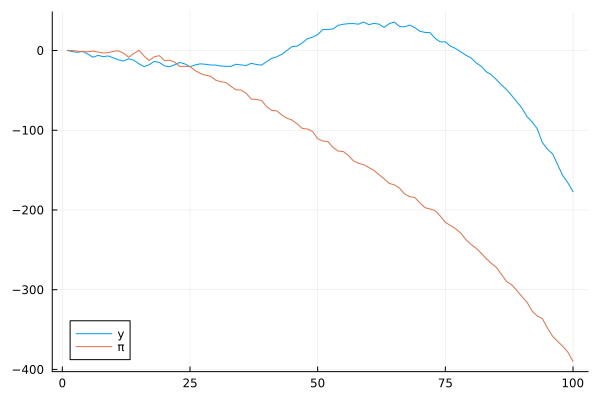

shape of obs = (100, 2)
shape of α = (100, 14)


In [4]:
n_obs = 100

#simulate data
obs, α = simulate_data(θ_true, cycle_order, n_obs)

# shape of obs
println("shape of obs = ", size(obs))
# shape of α
println("shape of α = ", size(α))

y = obs[:,1]
π = obs[:,2]

# plot data
plot(y, label="y")
plot!(π, label="π")
display(plot!())



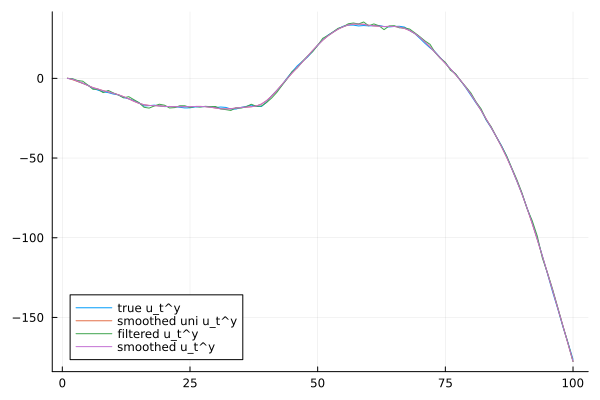

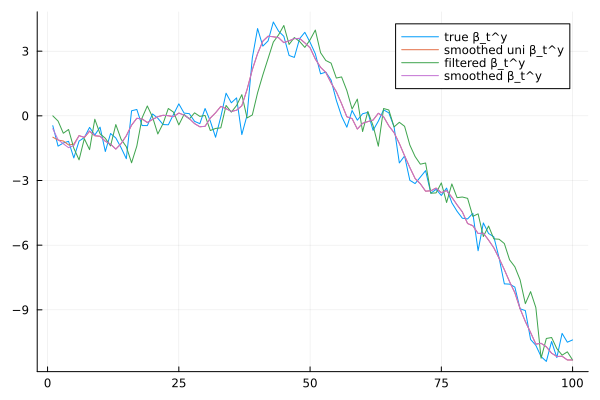

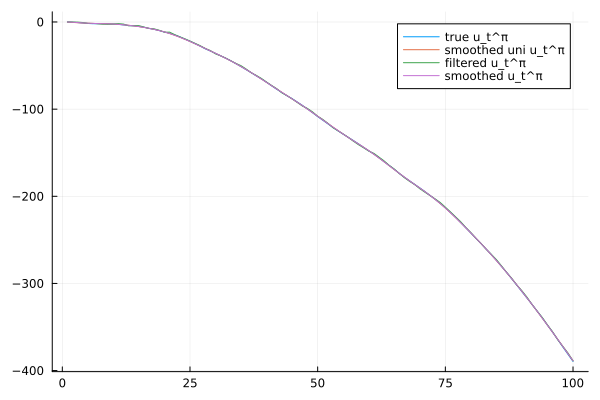

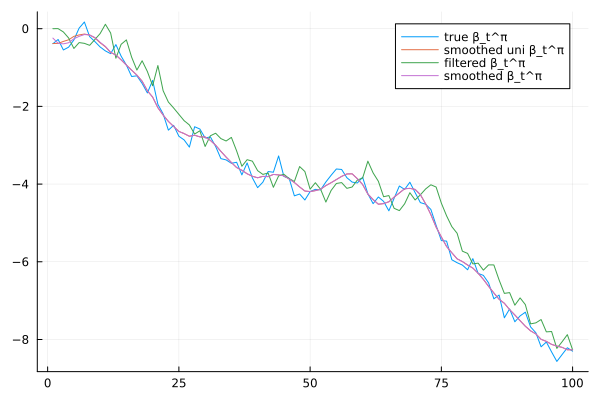

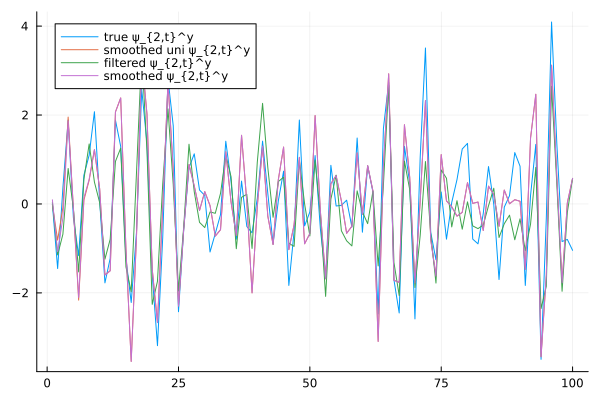

...

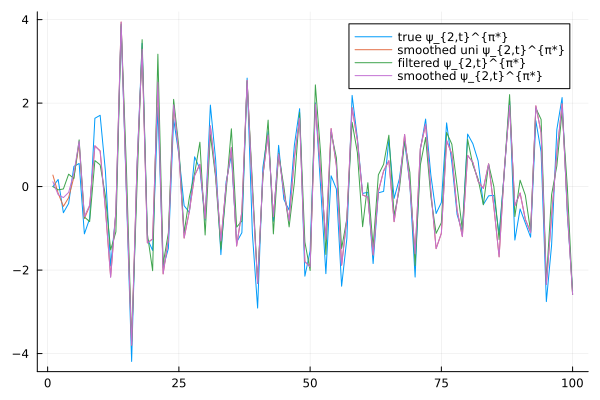

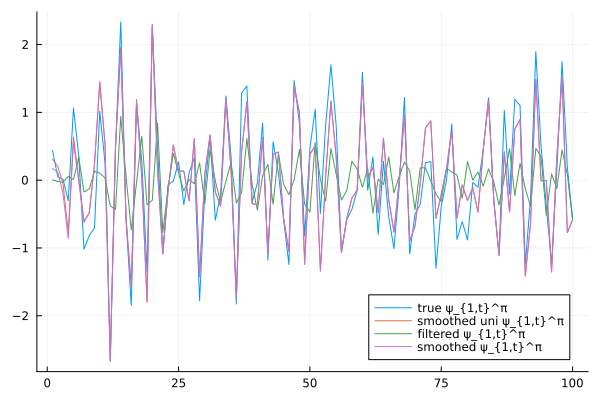

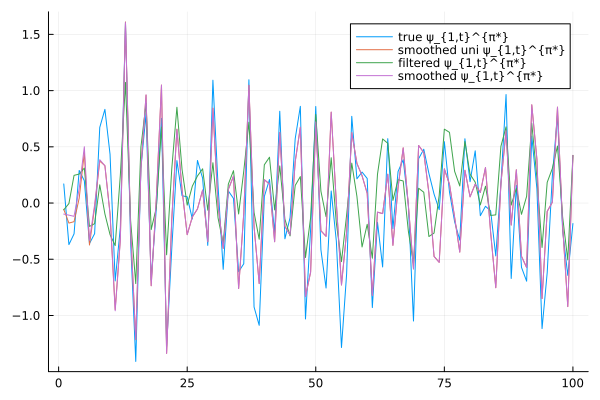

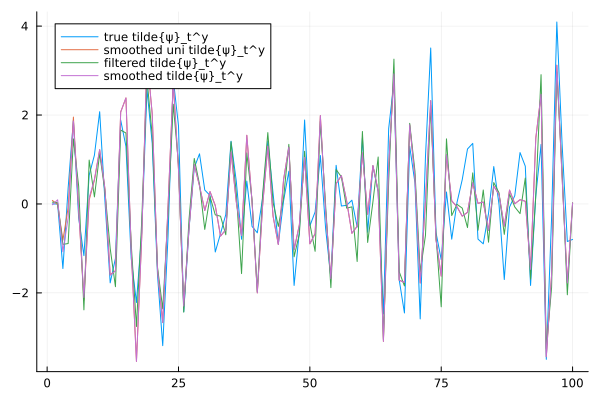

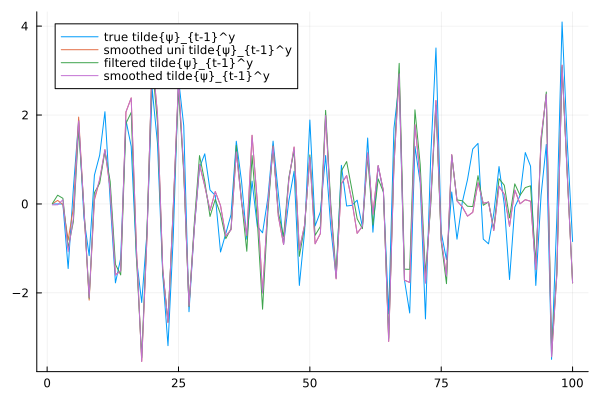

In [5]:
#Kalman filter 
α0 = zeros(size(T, 1))
P0 = Matrix(I, size(T, 1), size(T, 1))  # large initial uncertainty

LogL_diff, α_diff, P_diff = diffuse_kalman_filter(obs, θ_true, α0, P0, cycle_order, true, false)

LogL, α_f, P_f, α_p, P_p = kalman_filter(obs, θ_true, α0, P0, cycle_order)

α_s, P_s = kalman_smoother(θ_true, cycle_order, α_f, P_f, α_p, P_p)





for i in 1:size(α,2)
    plot(α[:,i], label="true $(α_elements[i])")
    plot!(α_diff[:,i], label="smoothed uni $(α_elements[i])")
    plot!(α_f[:,i], label="filtered $(α_elements[i])")
    plot!(α_s[:,i], label="smoothed $(α_elements[i])")
    display(plot!())
end






## MCMC

In [6]:
burn = 5000

θ_init, Σ, acceptance_rate = initialize_mcmc(obs, prior_info, α0, P0, θ_true, cycle_order;
                                 iter=40000, burn=burn, ω=0.01)


Initialization Phase 100%|███████████████████████████████| Time: 0:00:28KK


Initialization Acceptance Rate: 38.725 %


([0.6316342945467633 1.5462732680388394 … 0.0732196339057011 0.026654492754165128; 0.6316342945467633 1.5462732680388394 … 0.0732196339057011 0.026654492754165128; … ; 0.6517517849398173 1.61013797272336 … 0.046920461825543346 0.07587580891338454; 0.6517517849398173 1.61013797272336 … 0.046920461825543346 0.07587580891338454], [0.030418547469388605 0.0004228478664051585 … 1.429114358159282e-6 0.02059006610855177; 0.0004228478664051585 0.0038738130292134874 … -2.0854642882659756e-5 -0.006637009185230751; … ; 1.429114358159282e-6 -2.0854642882659756e-5 … 0.13732246632550604 -0.008362535746443965; 0.02059006610855177 -0.006637009185230751 … -0.008362535746443965 1.1809418132273148], 0.38725)

Initial chain shape: (40000, 13)
ρ = 0.6453343595331543
λ_c = 1.6461579606657237
c₁ = 0.5788227064377982
c₂ = 0.2720225415463365
v_ε, y = 0.00039481975418744543
v_ξ, y = 0.0006570384182007826
v_κ, y = 0.00046299315566215713
σ²_ε, y = 0.3960246869107865
σ²_ξ, y = 0.4793744225028941
σ²_κ, y = 0.48931652829749717
σ²_ε, π = 0.056616337178254164
σ²_ξ, π = 0.10250977500384069
σ²_κ, π = 0.11638162196500931


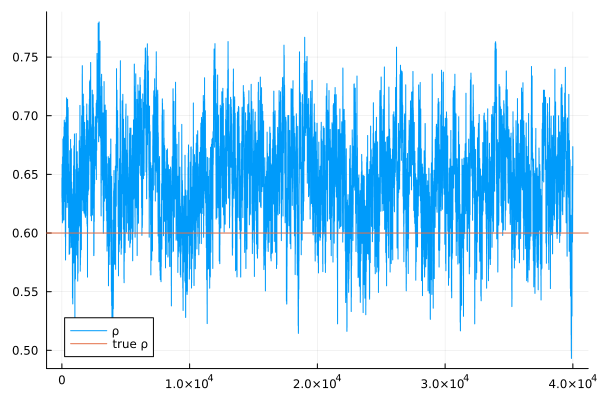

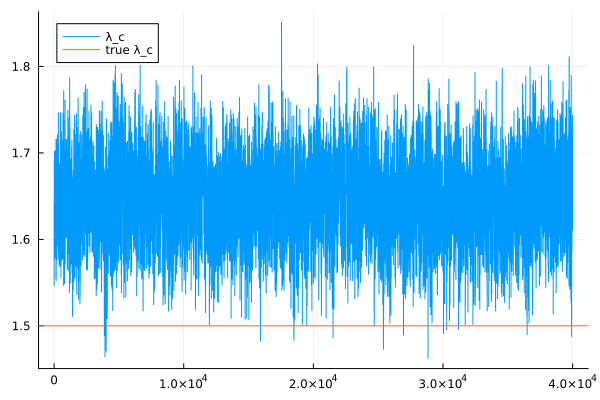

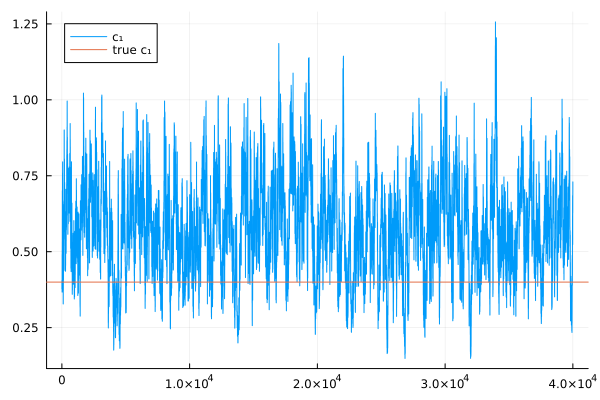

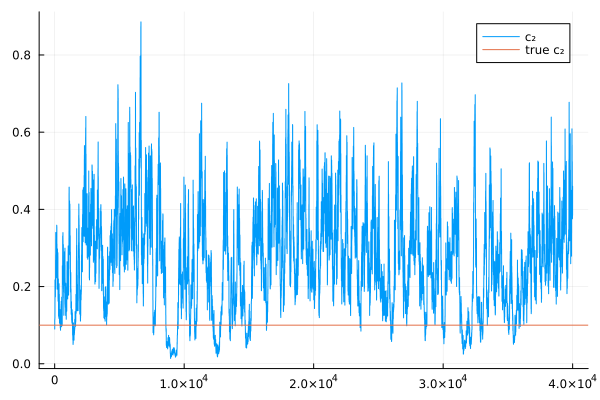

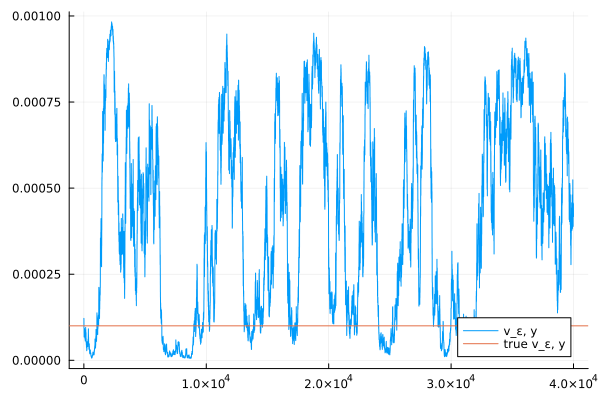

...

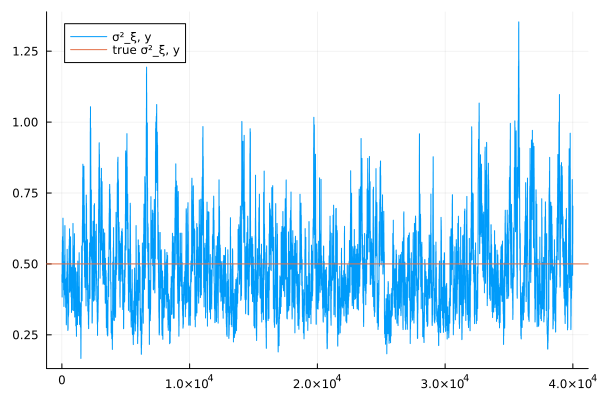

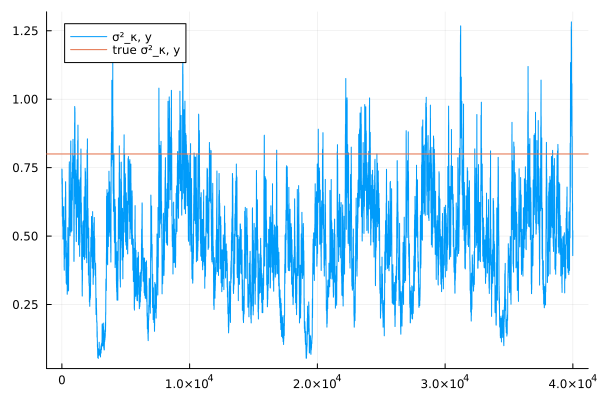

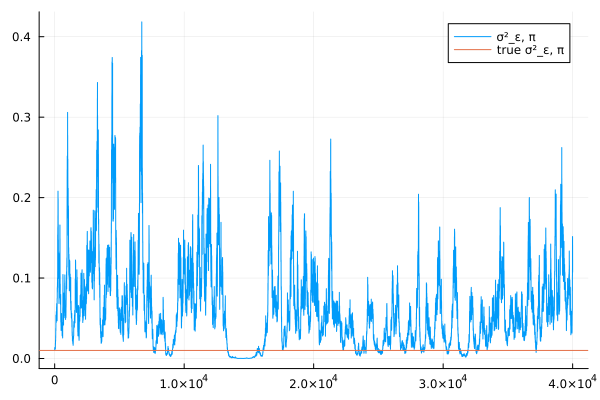

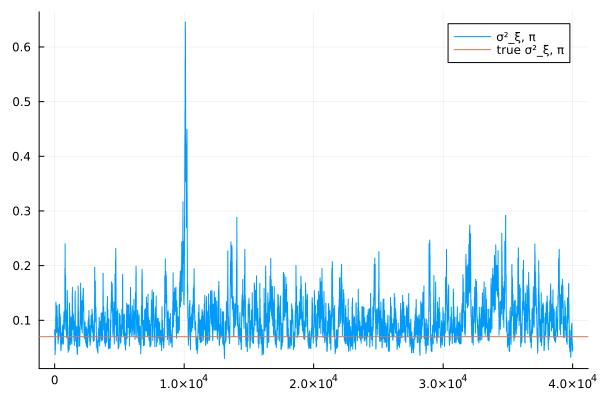

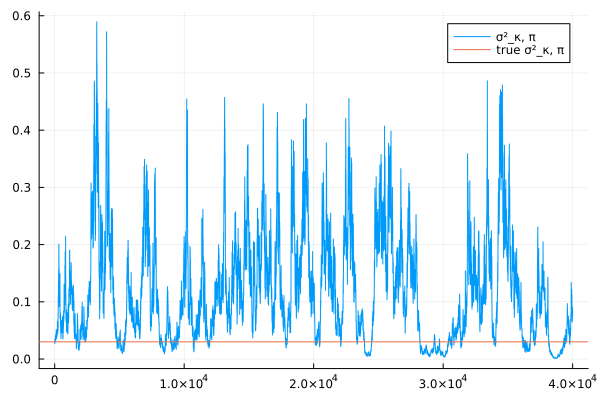

In [7]:
println("Initial chain shape: ", size(θ_init))
# for each parameter print mean
for i in 1:size(θ_init, 2)
    println("$(θ_elements[i]) = $(mean(θ_init[burn+1:end,i]))")
end


#Print trace plot and add true value
for i in 1:size(θ_init, 2)
    plot(θ_init[:,i], label="$(θ_elements[i])")
    hline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end

In [10]:
θ_rec, α_draws, acceptance_rate =  mcmc_recursion(obs,prior_info,α0, P0,cycle_order;
    iter = 10000,
    burn = 5000,
    θ_init = θ_init[end,:],
    Σ = Σ,
    ω = 0.01)


Recursion Phase 100%|████████████████████████████████████| Time: 0:00:31


Recursion Acceptance Rate: 38.51 %


([0.6517517849398173 1.61013797272336 … 0.046920461825543346 0.07587580891338451; 0.6565531518984294 1.6713677888429737 … 0.04767139361157712 0.07299521205318855; … ; 0.7406795845998708 1.5964021329047355 … 0.1306648164960549 0.2119904510015255; 0.7406795845998708 1.5964021329047355 … 0.1306648164960549 0.2119904510015255], [0.6232498628302857 -0.82460259269672 … -166.40409252320063 -177.65306514220123; 1.1662506362510112 -0.4699943208555142 … -165.97889650284247 -178.5482292924171; … ; 0.20102226996402006 -1.0465292834233026 … -166.1299164856249 -178.14922946544286; 0.9345427642618143 -0.7581204238154036 … -165.94719462261168 -177.81367648752712;;; -1.4478524555270058 -1.0375817527788649 … -11.248972619000446 -10.016373677656441; -1.6362449571065256 -1.2724862745408272 … -12.569332789574602 -10.387233590094809; … ; -1.2475515533873227 -1.5936948267359692 … -12.019312979817965 -12.811790298693166; -1.6926631880772183 -1.0010692642739634 … -11.866481864915418 -11.276698194137;;; 1.28298

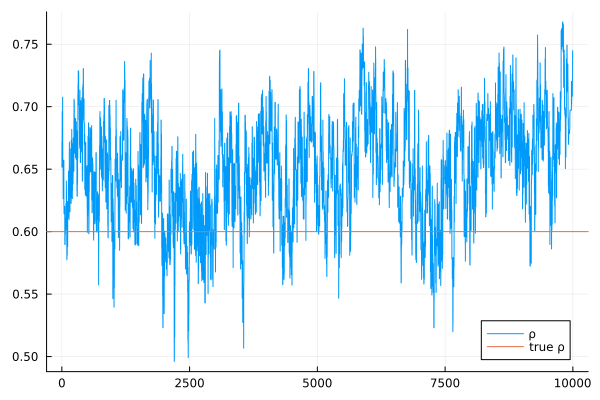

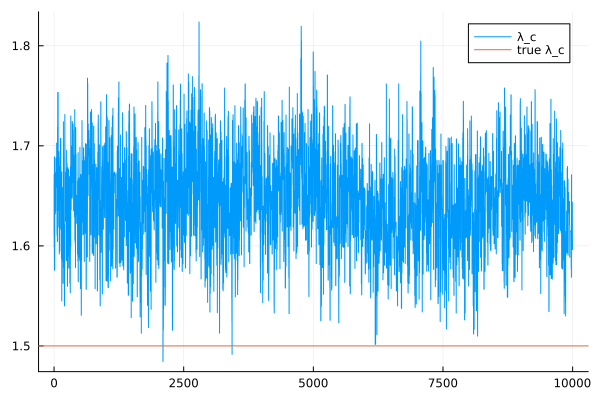

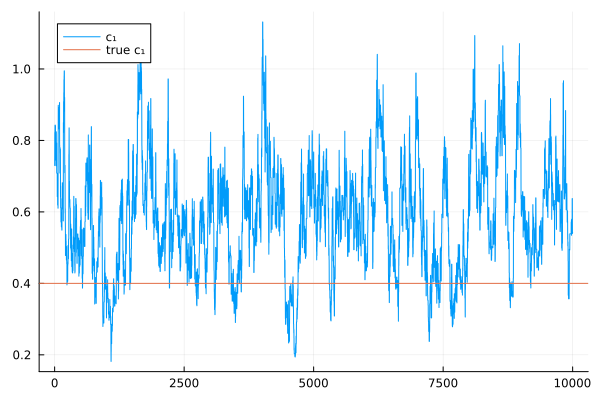

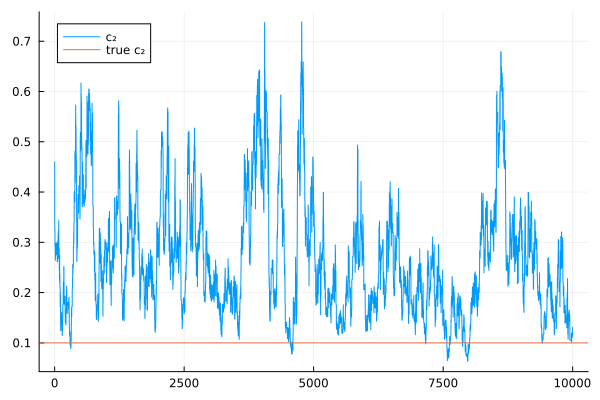

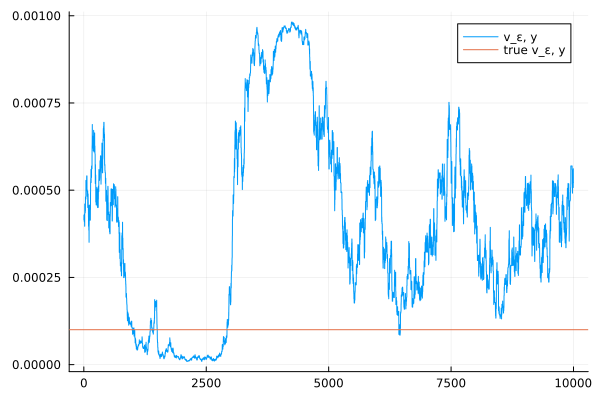

...

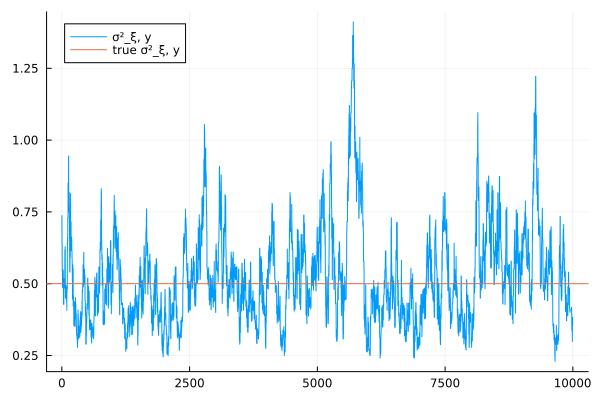

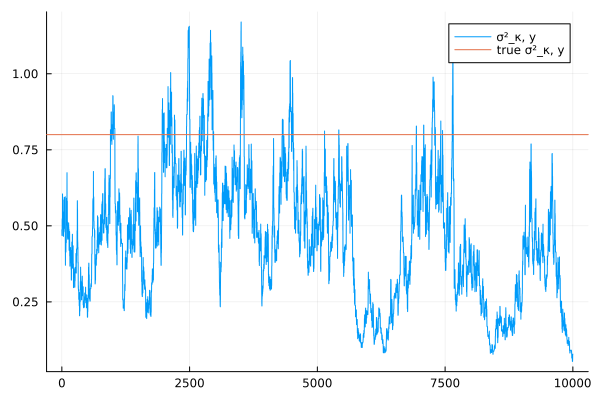

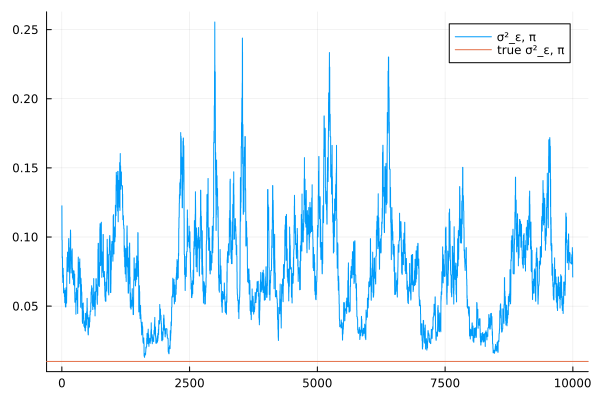

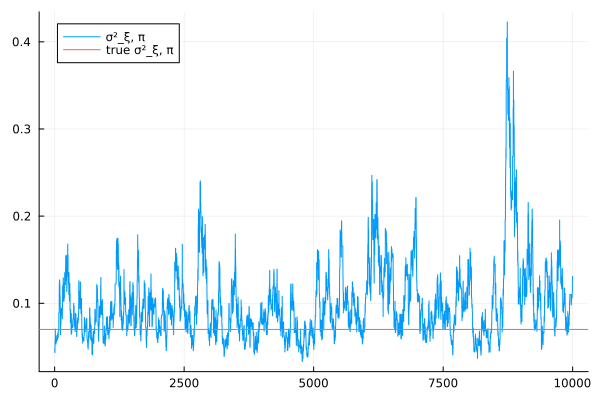

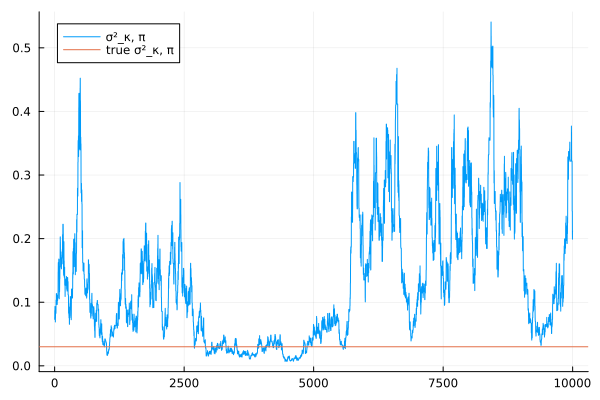

Recovered chain shape: (10000, 13)
ρ = 0.6593613443073402
λ_c = 1.6393502959661819
c₁ = 0.6004890971619139
c₂ = 0.23083859736812246
v_ε, y = 0.00037798461405299887
v_ξ, y = 0.00019208175880506284
v_κ, y = 0.0007718176222425912
σ²_ε, y = 0.3574944321147668
σ²_ξ, y = 0.5469378826301657
σ²_κ, y = 0.36912983815052547
σ²_ε, π = 0.07435133258866804
σ²_ξ, π = 0.11216977438852012
σ²_κ, π = 0.18357870363482873


In [11]:
println("Recovered chain shape: ", size(θ_rec))
# for each parameter print mean
for i in 1:size(θ_rec, 2)
    println("$(θ_elements[i]) = $(mean(θ_rec[burn+1:end,i]))")
end

#Print trace plot and add true value
for i in 1:size(θ_init, 2)
    plot(θ_rec[:,i], label="$(θ_elements[i])")
    hline!([θ_true[i]], label="true $(θ_elements[i])")
    display(plot!())
end



Mean of α_draws: (1, 100, 14)


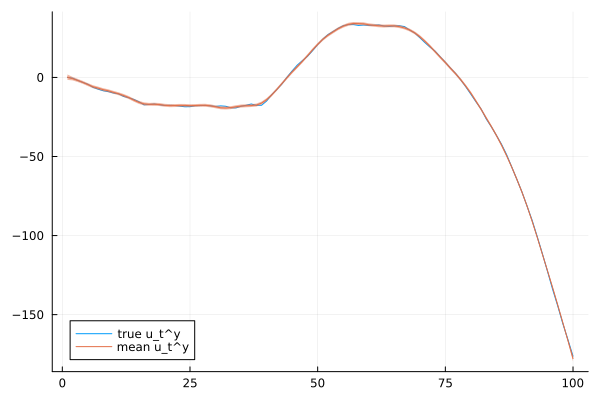

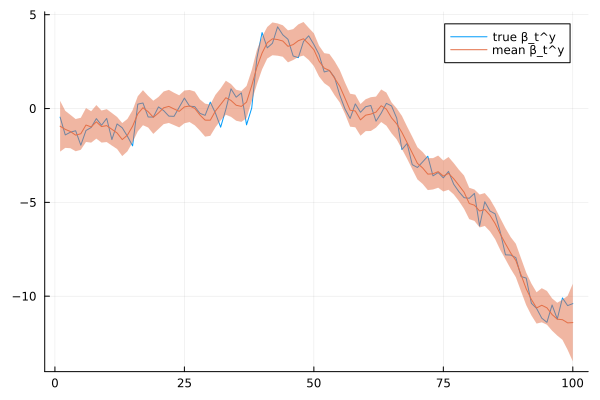

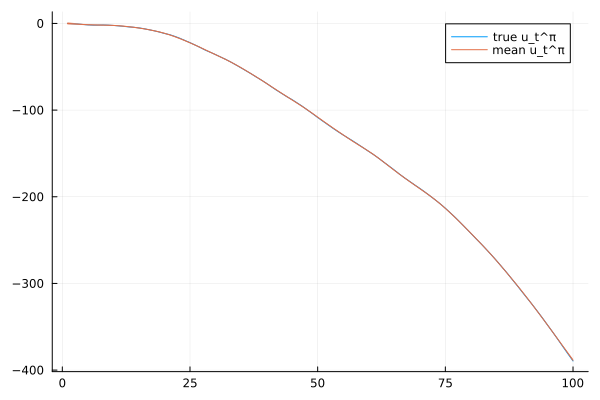

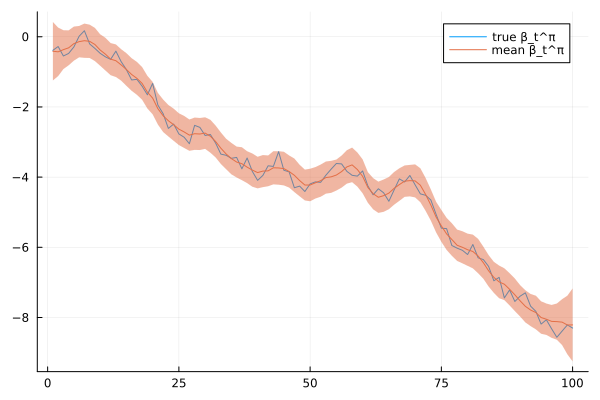

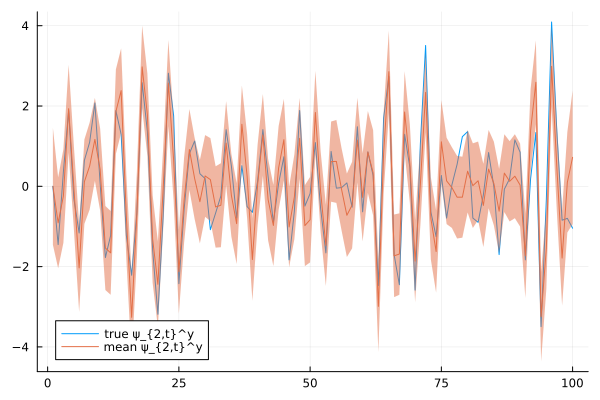

...

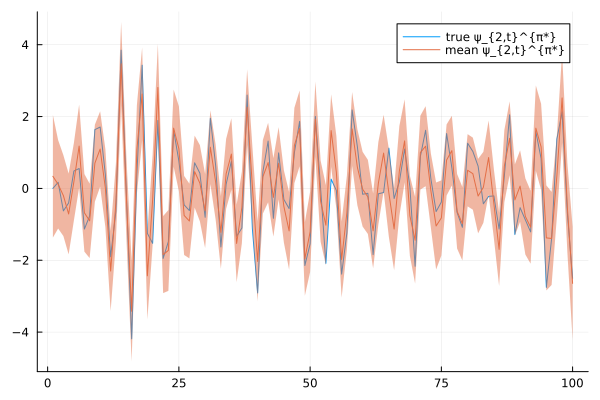

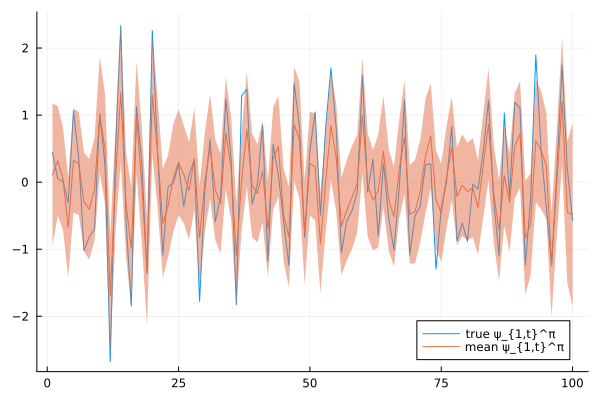

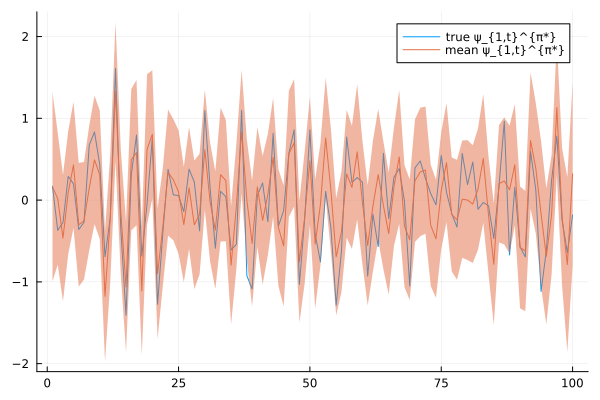

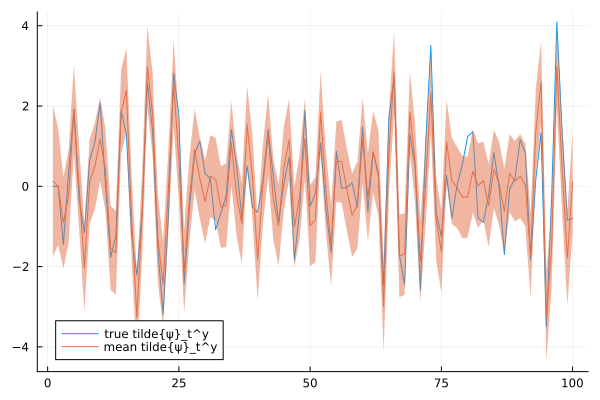

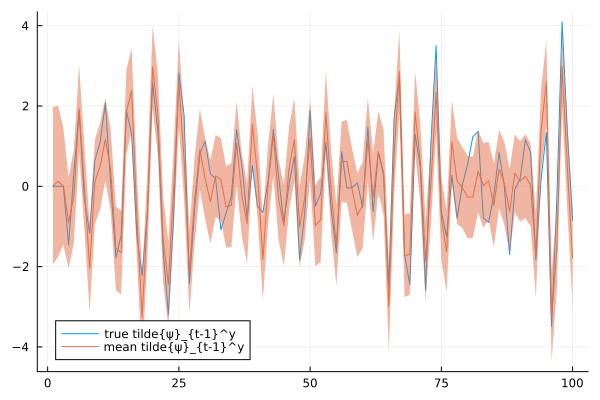

In [12]:
# Compute the mean over iterations (dimension 1)
α_mean = mean(α_draws, dims=1)
println("Mean of α_draws: ", size(α_mean))

# Compute the 2.5% and 97.5% quantiles 
α_ci = mapslices(x -> quantile(x, [0.025, 0.975]), α_draws, dims=1)



# Plot true states, mean of states, and confidence intervals of states
for i in 1:size(α_mean, 3)
    plot(α[:, i], label="true $(α_elements[i])")
    plot!(α_mean[1, :, i], ribbon=(α_ci[2, :, i] .- α_mean[1, :, i]), label="mean $(α_elements[i])")
    display(plot!())
end


## MLE

In [ ]:
# using Optim

# # # True parameters
# # ρ = 0.9
# # λ_c = 0.1
# # c₁ = 0.1
# # c₂ = 0.1
# # v_ε = 1e-4
# # v_ξ = 1e-4
# # v_κ = 1e-4  
# # σ²_ε_y = 0.3
# # σ²_ξ_y = 0.5
# # σ²_κ_y = 0.8
# # σ²_ε_π = 0.01
# # σ²_ξ_π = 0.07
# # σ²_κ_π = 0.03

# # Define bounds for each parameter:

# lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0, 0, 0, 0, 0, 0, 0, 0]
# upper_bounds = [1.0, 3.0, 3.0, 3.0, 3.0, 1, 1, 1, 1, 1, 1, 1, 1]

# # Initial guess for θ (make sure these values lie within the bounds)
# θ_init = θ_true 

# # The objective function is as defined before:
# objective(θ) = neg_log_likelihood(θ, obs, α0, P0, cycle_order)

# # Optimize using Fminbox to enforce the bounds, wrapping a BFGS optimizer.
# res = optimize(objective, lower_bounds, upper_bounds, θ_init, Fminbox(BFGS()))

# # Extract the estimated parameters
# θ_est = Optim.minimizer(res)

# # Print the results:
# println("\nMLE Results (with bounded optimization):")
# for (i, param_name) in enumerate(θ_elements)
#     println("Estimated $(param_name): $(θ_est[i])   (True value: $(θ_true[i]))")
# end
# println("\nFinal negative log-likelihood: ", Optim.minimum(res))


In [ ]:
# # estimate states
# LogL_diff, α_diff, P_diff = diffuse_kalman_filter(obs, θ_est, α0, P0, cycle_order, true, false)

# #plot estimated states and true states
# for i in 1:size(α,2)
#     plot(α[:,i], label="true $(α_elements[i])")
#     plot!(α_diff[:,i], label="smoothed uni $(α_elements[i])")
#     display(plot!())
# end

